In [16]:
%pip install matplotlib scienceplots pandas ipywidgets plotly nbformat scipy

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.4/60.4 kB 1.4 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 38.4/38.4 MB 17.7 MB/s eta 0:00:0000:0100:01
Note: you may need to restart the kernel to use updated packages.


In [17]:
import os, sys
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import scienceplots
import pandas as pd
import ipywidgets as widgets
import plotly.graph_objects as go
import numpy as np


In [18]:
plt.style.use(['science','notebook','no-latex'])
plt.rcParams['figure.figsize'] = [8, 6]

In [19]:
from multiprocessing.dummy import Pool as ThreadPool

# Data directory
data_dir = "data/"

def read_csv(file_path):
    return pd.read_csv(file_path, sep='\s+')

# Read all .out files in the data directory into a list of dataframes with multiple threads
data = []
with ThreadPool(4) as pool:
    data = pool.map(read_csv, [data_dir + file for file in os.listdir(data_dir) if file.endswith(".out")])

# Display the list of dataframes
data

[      sim   state  soln  dist_x         time  step       pH       pe  \
 0       1  i_soln     0 -99.000        -99.0   -99  5.60100  13.8920   
 1       1  i_soln     1 -99.000        -99.0   -99  8.10000   4.0000   
 2       1   react     0 -99.000          0.0     1  7.77670  11.2773   
 3       2  i_exch     1 -99.000        -99.0   -99  8.10000   4.0000   
 4       3  i_surf     1 -99.000        -99.0   -99  8.10000   4.0000   
 ...   ...     ...   ...     ...          ...   ...      ...      ...   
 3201    1  transp     7   0.325  152564000.0   290  7.29998  14.0903   
 3202    1  transp     8   0.375  152564000.0   290  7.27099  14.1208   
 3203    1  transp     9   0.425  152564000.0   290  7.23812  14.1437   
 3204    1  transp    10   0.475  152564000.0   290  7.19226  14.1689   
 3205    1  transp    11   0.525  152564000.0   290  8.23925  13.1214   
 
              N        Na  ...  k_Ilmenite  dk_Ilmenite  k_Glass  dk_Glass  \
 0     0.000019  0.000089  ...         0.0  

In [20]:
for raw in data:
    # add two columns: years and days, time column is in seconds
    raw['days'] = raw['time'] / 86400
    raw['years'] = raw['time'] / 31536000
    raw = raw[raw['time'] >= 0.0]

<Axes: title={'center': 'Effluent Calcite'}, xlabel='years', ylabel='Carbon captuere\n(tones CO2/ha)'>

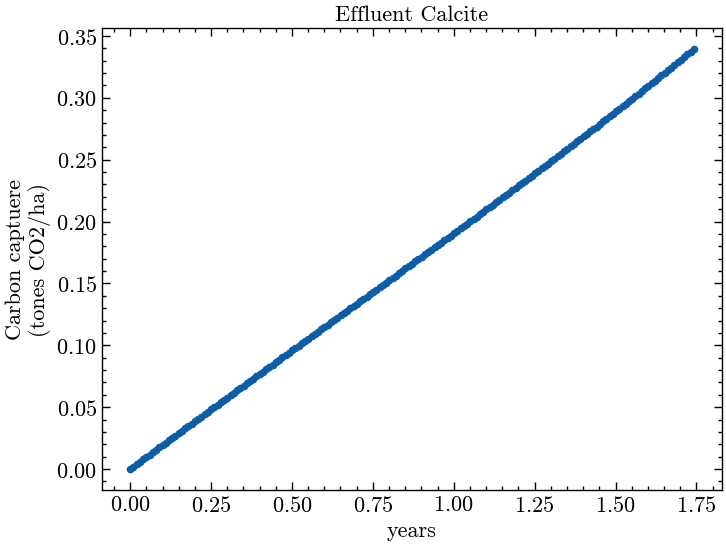

In [21]:
df = data[55]
# Effluent calcite
# select solution 11, average 11 by years
eff_c = (df[df['soln'] == 11])[["step","years","Calcite"]].groupby('step').mean()
# convert to M (tones CO2/ha)
eff_c['Calcite'] = eff_c['Calcite']*(500000/10)*44/1000000 
# rename
eff_c.rename(columns={"Calcite": "Effluent_Calcite"},inplace = True)
eff_c.plot.scatter(x="years",y="Effluent_Calcite", title="Effluent Calcite",ylabel="Carbon captuere\n(tones CO2/ha)")

# Total Co2 Diagram

In [22]:
import plotly.graph_objects as go

# Initialize lists to store data
x_data = []
y_data = []
z_data = []
color_data = []

# Iterate over each dataframe in the list
for i, df in enumerate(data):
    # Extract relevant data for the plot
    soil_c = (df[df['soln'].between(1, 10)])[["step", "years", "Calcite"]].groupby("step").mean()
    soil_c['Calcite'] = soil_c['Calcite'] * 600000 * 40 / 1000000 
    soil_c.rename(columns={"Calcite": "Soil_Calcite"}, inplace=True)
    
    # Append data to lists
    x_data.extend([i] * len(soil_c))  # X-axis (use index of dataframe)
    y_data.extend(soil_c['years'])    # Y-axis
    z_data.extend(soil_c['Soil_Calcite'])  # Z-axis
    color_data.extend([i] * len(soil_c))  # Color by index of dataframe

# Create a 3D scatter plot
fig = go.Figure(data=[go.Scatter3d(
    x=x_data,  # X-axis
    y=y_data,  # Y-axis
    z=z_data,  # Z-axis
    mode='markers',
    marker=dict(
        size=6,
        color=color_data,  # Color by index of dataframe
        colorscale='Viridis',  # Choose a colorscale
        opacity=0.8
    )
)])

# Set titles and axis labels
fig.update_layout(
    title='3D Scatter Plot of Soil Calcite',
    scene=dict(
        xaxis=dict(title='Dataframe Index'),  # Use index of dataframe as X-axis
        yaxis=dict(title='Years'),
        zaxis=dict(title='Soil Calcite')
    )
)

# Show the plot
fig.show()





# Line plot of the same data

In [26]:
import numpy as np
import plotly.graph_objects as go

# Initialize lists to store data
x_data = []
y_data = []
z_data = []
color_data = []

# Iterate over each dataframe in the list
for i, df in enumerate(data):
    # Extract relevant data for the plot
    soil_c = (df[df['soln'].between(1, 10)])[["step", "years", "Calcite"]].groupby("step").mean()
    soil_c['Calcite'] = soil_c['Calcite'] * 600000 * 40 / 1000000 
    soil_c.rename(columns={"Calcite": "Soil_Calcite"}, inplace=True)
    
    # Remove extreme outliers and loops
    soil_c = soil_c[np.abs(soil_c['Soil_Calcite'] - soil_c['Soil_Calcite'].mean()) <= 3 * soil_c['Soil_Calcite'].std()]
    soil_c = soil_c.drop_duplicates(subset=['Soil_Calcite'])
    
    # Append data to lists
    x_data.extend([i] * len(soil_c))  # X-axis (use index of dataframe)
    y_data.extend(soil_c['years'])    # Y-axis
    z_data.extend(soil_c['Soil_Calcite'])  # Z-axis
    color_data.extend([i] * len(soil_c))  # Color by index of dataframe

# Create a 3D line plot
fig = go.Figure(data=[go.Scatter3d(
    x=x_data,  # X-axis
    y=y_data,  # Y-axis
    z=z_data,  # Z-axis
    mode='lines',
    line=dict(
        color=color_data,  # Color by index of dataframe
        colorscale='Viridis',  # Choose a colorscale
        width=2
    )
)])

# Set titles and axis labels
fig.update_layout(
    title='3D Line Plot of Soil Calcite',
    scene=dict(
        xaxis=dict(title='Dataframe Index'),  # Use index of dataframe as X-axis
        yaxis=dict(title='Years'),
        zaxis=dict(title='Soil Calcite')
    )
)

# Show the plot
fig.show()


In [27]:
import plotly.graph_objects as go

# Initialize lists to store data
x_data_eff = []
y_data_eff = []
z_data_eff = []

# Iterate over each dataframe in the list
for i, df in enumerate(data):
    # Extract relevant data for the plot
    eff_c = (df[df['soln'] == 11])[["step", "years", "Calcite"]].groupby('step').mean()
    eff_c['Calcite'] = eff_c['Calcite'] * (500000 / 10) * 44 / 1000000 
    eff_c.rename(columns={"Calcite": "Effluent_Calcite"}, inplace=True)
    
    # Append data to lists
    x_data_eff.extend([i] * len(eff_c))  # X-axis (use index of dataframe)
    y_data_eff.extend(eff_c['years'])    # Y-axis
    z_data_eff.extend(eff_c['Effluent_Calcite'])  # Z-axis

# Create a 3D scatter plot
fig_eff = go.Figure(data=[go.Scatter3d(
    x=x_data_eff,  # X-axis
    y=y_data_eff,  # Y-axis
    z=z_data_eff,  # Z-axis
    mode='markers',
    marker=dict(
        size=6,
        color=x_data_eff,  # Color by index of dataframe
        colorscale='Viridis',  # Choose a colorscale
        opacity=0.8
    )
)])

# Set titles and axis labels
fig_eff.update_layout(
    title='3D Scatter Plot of Effluent Calcite',
    scene=dict(
        xaxis=dict(title='Dataframe Index'),  # Use index of dataframe as X-axis
        yaxis=dict(title='Years'),
        zaxis=dict(title='Effluent Calcite')
    )
)

# Show the plot
fig_eff.show()


In [32]:
import plotly.graph_objects as go

# Initialize lists to store data
x_data = []
y_data = []
z_data = []

# Iterate over each dataframe in the list
for i, df in enumerate(data):
    # Extract relevant data for the plot
    eff_b = (df[df['soln'] == 11])[["step", "years", "C(4)"]].groupby('step').mean()
    eff_b['C(4)'] = eff_b['C(4)'] * (500000 / 10) * 44 / 1000000
    eff_b['Effluent_bicarbonate'] = eff_b["C(4)"].cumsum()
    
    # Append data to lists
    x_data.extend([i] * len(eff_b))  # X-axis (use index of dataframe)
    y_data.extend(eff_b['years'])    # Y-axis
    z_data.extend(eff_b['Effluent_bicarbonate'])  # Z-axis

# Create a 3D scatter plot
fig = go.Figure(data=[go.Scatter3d(
    x=x_data,  # X-axis
    y=y_data,  # Y-axis
    z=z_data,  # Z-axis
    mode='markers',
    marker=dict(
        size=6,
        color=x_data,  # Color by index of dataframe
        colorscale='Viridis',  # Choose a colorscale
        opacity=0.8
    )
)])

# Set titles and axis labels
fig.update_layout(
    title='3D Scatter Plot of Effluent Bicarbonate',
    scene=dict(
        xaxis=dict(title='Dataframe Index'),  # Use index of dataframe as X-axis
        yaxis=dict(title='Years'),
        zaxis=dict(title='Effluent Bicarbonate (tones CO2/ha)')
    )
)

# Show the plot
fig.show()


In [31]:
import plotly.graph_objects as go

# Initialize lists to store data
x_data = []
y_data = []
z_data = []

# Iterate over each dataframe in the list
for i, df in enumerate(data):
    # Extract relevant data for the plot
    eff_c["Soil_Calcite"] = soil_c["Soil_Calcite"]
    eff_c["Effluent_bicarbonate"] = eff_b["Effluent_bicarbonate"]
    eff_c["Total_Capture"] = eff_c['Effluent_bicarbonate'] + eff_c["Effluent_Calcite"] + eff_c["Soil_Calcite"]
    
    # Append data to lists
    x_data.extend([i] * len(eff_c))  # X-axis (use index of dataframe)
    y_data.extend(eff_c['years'])    # Y-axis
    z_data.extend(eff_c['Total_Capture'])  # Z-axis

# Create a 3D scatter plot
fig = go.Figure(data=[go.Scatter3d(
    x=x_data,  # X-axis
    y=y_data,  # Y-axis
    z=z_data,  # Z-axis
    mode='markers',
    marker=dict(
        size=6,
        color=x_data,  # Color by index of dataframe
        colorscale='Viridis',  # Choose a colorscale
        opacity=0.8
    )
)])

# Set titles and axis labels
fig.update_layout(
    title='3D Scatter Plot of Total Capture',
    scene=dict(
        xaxis=dict(title='Dataframe Index'),  # Use index of dataframe as X-axis
        yaxis=dict(title='Years'),
        zaxis=dict(title='Total Capture (tones CO2/ha)')
    )
)

# Show the plot
fig.show()


In [33]:
import plotly.graph_objects as go

# Initialize lists to store data
x_data = []
y_data = []
z_data = []
color_data = []

# Iterate over each dataframe in the list
for i, df in enumerate(data):
    # Extract relevant data for the plot
    soil_c = (df[df['soln'].between(1, 10)])[["step", "years", "Calcite"]].groupby("step").mean()
    soil_c['Calcite'] = soil_c['Calcite'] * 500000 * 44 / 1000000 
    soil_c.rename(columns={"Calcite": "Soil_Calcite"}, inplace=True)
    
    # Append data to lists
    x_data.extend([i] * len(soil_c))  # X-axis (use index of dataframe)
    y_data.extend(soil_c['years'])    # Y-axis
    z_data.extend(soil_c['Soil_Calcite'])  # Z-axis

# Create a 3D scatter plot
fig = go.Figure(data=[go.Scatter3d(
    x=x_data,  # X-axis (use index of dataframe)
    y=y_data,  # Y-axis
    z=z_data,  # Z-axis
    mode='markers',
    marker=dict(
        size=6,
        color=x_data,  # Color by index of dataframe
        colorscale='Viridis',  # Choose a colorscale
        opacity=0.8
    )
)])

# Set titles and axis labels
fig.update_layout(
    title='3D Scatter Plot of Soil Calcite',
    scene=dict(
        xaxis=dict(title='Dataframe Index'),  # Use index of dataframe as X-axis
        yaxis=dict(title='Years'),
        zaxis=dict(title='Soil Calcite')
    )
)

# Show the plot
fig.show()
